# Engineered Data Extraction



### Here we will load the engineered data, and then work with that data to clean, pre process the data sand begin the model training.

In [1]:
#Import all necessary libraries
from datetime import datetime
import warnings
warnings.filterwarnings('ignore')

import imblearn
import matplotlib.pyplot as plt
import scipy.stats as stats
import numpy as np
import pandas as pd
import seaborn as sns
import sklearn
import gc
import tqdm
import re
from collections import defaultdict
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report, roc_auc_score, roc_curve, auc
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import RandomizedSearchCV
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import StratifiedKFold
from sklearn.model_selection import KFold
import xgboost as xgb
from xgboost import XGBClassifier
from sklearn.svm import SVC
from sklearn.neighbors import KNeighborsClassifier
from sklearn.naive_bayes import GaussianNB
import plotly.graph_objs as go
from plotly.offline import init_notebook_mode, iplot
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import StandardScaler
from scipy.stats import chi2_contingency


import matplotlib.pyplot as plt
import plotly
import matplotlib.gridspec as gridspec
import sys

In [2]:
%reload_ext autoreload
%autoreload 2

# Set precision for pd and np (np: suppress also sci notation)
np.set_printoptions(precision=3, suppress=True)
pd.options.display.float_format = "{:,.4g}".format

print(sklearn.__version__)  # Version tested on sklearn.__version__ == 1.2.2

1.2.2


#### 1. Load the data

In [3]:
#Entire dataset
entire_df = pd.read_csv('./entire_df.csv')

This is the training set that we will use to train our model. We will now explore the training set.

In [4]:
entire_df.head()

,Patient,Age,Gender,Citizen,Target,Height (in cm),Weight (in kg),BMI in kg/m2,Body Temperature (in DegC),Diastolic Blood Pressure in mmHg,Systolic Blood Pressure in mmHg,Heart Rate in bpm,Respiratory Rate in bpm,Category,Subcategory,Extension
0,192699,25,Female,EMIRATI,0,156,108,44,36.3,81,119,82,20,D,50,0.9
1,166710,57,Female,EMIRATI,0,NaN,NaN,NaN,37,77,111,88,18,E,78,0.5
2,2644517,31,Female,Emirati,1,163.6,102.9,38.45,36.8,80,119,76,16,R,11,0.2
3,1079401,44,Female,Unknown,0,161,63,24,36.7,70,105,87,22,N,91,0.1
4,317560,8,Male,EMIRATI,0,135,NaN,NaN,NaN,76.07,NaN,89,NaN,Z,9,NaN


In [5]:
entire_df.shape

(301950, 16)

In [6]:
test_df = pd.read_csv('./emb.csv')
test_df.head()

,Patient,TestItemCode_Description,ResultValue,ResultValueUnits,ResultInterpretation,Target
0,192699,COVID-19 PCR,Not Detected,NaN,Normal,0
1,166710,eGFR,67.7,ZZ,Normal,0
2,2644517,"Glucose, Fasting-FBS, Blood",87,mg/dL,Normal,1
3,1079401,BETA HCG Quantitative,0.100,IU/L,NaN,0
4,317560,Influenza B Ab,NEG.,NaN,Normal,0


In [7]:
test_df.drop(['Target'], axis=1, inplace=True)

In [8]:
#Add the columns from test df to entire df, where the Patient ID matches
entire_df = entire_df.merge(test_df, on='Patient', how='left')
entire_df.shape


(358090, 20)

In [10]:
def stats(data):
    #check the shaape of the data
    print("The shape of the data is: ", data.shape)
    #number of rows
    print("The number of rows is: ", data.shape[0])
    #number of columns
    print("The number of columns is: ", data.shape[1])
    #check the data types
    print("The data types are: ", data.dtypes)
    #check the null values
    print("The null values are: ", data.isnull().sum())
    #check the number of unique values
    print("The number of unique values are: ", data.nunique())
    #check the number of categorical columns in the df
    print("The number of categorical columns are: ", len(data.select_dtypes(include = "object").columns))
    #check the number of numerical columns in the df
    print("The number of numerical columns are: ", len(data.select_dtypes(include = ["int64", "float64"]).columns))
    return

In [11]:
stats(entire_df)

The shape of the data is:  (358090, 20)
The number of rows is:  358090
The number of columns is:  20
The data types are:  Patient                               int64
Age                                 float64
Gender                               object
Citizen                              object
Target                                int64
Height (in cm)                      float64
Weight (in kg)                      float64
BMI in kg/m2                        float64
Body Temperature (in DegC)          float64
Diastolic Blood Pressure in mmHg    float64
Systolic Blood Pressure in mmHg     float64
Heart Rate in bpm                   float64
Respiratory Rate in bpm             float64
Category                             object
Subcategory                          object
Extension                            object
TestItemCode_Description             object
ResultValue                          object
ResultValueUnits                     object
ResultInterpretation                 objec

In [12]:
entire_df.dtypes.value_counts()

float64    9
object     9
int64      2
Name: count, dtype: int64

In [13]:
entire_df.describe().T

,count,mean,std,min,25%,50%,75%,max
Patient,3.581e+05,1.161e+06,7.551e+05,5.927e+04,4.331e+05,1.231e+06,1.44e+06,3.231e+06
Age,3.581e+05,38.95,19.97,0,26,40,53,114
Target,3.581e+05,0.4169,0.493,0,0,0,1,1
Height (in cm),2.999e+05,140.1,382.9,0,147,159,168,1.752e+05
Weight (in kg),3.178e+05,67.36,144,0,54.5,72,85.4,7.107e+04
BMI in kg/m2,2.492e+05,677.6,2.275e+04,0,0,26,31,1.26e+06
Body Temperature (in DegC),3.358e+05,35.47,17.83,0,36.5,36.6,37,"3,802"
Diastolic Blood Pressure in mmHg,3.581e+05,75.41,"2,030",0,68,76,80,1.215e+06
Systolic Blood Pressure in mmHg,3.185e+05,118.8,30.69,0,110,121,133,"1,600"
Heart Rate in bpm,3.363e+05,81.1,179,0,74,82,92,1.021e+05


In [14]:
#print the count of the patients where target is both 0 and 1
print("The count of the patients where target is 0: ", entire_df[entire_df['Target'] == 0].shape[0])
print("The count of the patients where target is 1: ", entire_df[entire_df['Target'] == 1].shape[0])

#print the intersection of the patients where target is both 0 and 1
print("The intersection of the patients where target is 0 and 1: ", len(set(entire_df[entire_df['Target'] == 0]['Patient']).intersection(set(entire_df[entire_df['Target'] == 1]['Patient']))))



The count of the patients where target is 0:  208809
The count of the patients where target is 1:  149281
The intersection of the patients where target is 0 and 1:  28070


In [15]:
#Excluding the patients where target is both 0 and 1
extract_df = entire_df[~entire_df['Patient'].isin(list(set(entire_df[entire_df['Target'] == 0]['Patient']).intersection(set(entire_df[entire_df['Target'] == 1]['Patient']))))]
extract_df.shape

(245810, 20)

In [16]:
extract_df.head()

,Patient,Age,Gender,Citizen,Target,Height (in cm),Weight (in kg),BMI in kg/m2,Body Temperature (in DegC),Diastolic Blood Pressure in mmHg,Systolic Blood Pressure in mmHg,Heart Rate in bpm,Respiratory Rate in bpm,Category,Subcategory,Extension,TestItemCode_Description,ResultValue,ResultValueUnits,ResultInterpretation
0,192699,25,Female,EMIRATI,0,156,108,44,36.3,81,119,82,20,D,50,0.9,COVID-19 PCR,Not Detected,NaN,Normal
3,2644517,31,Female,Emirati,1,163.6,102.9,38.45,36.8,80,119,76,16,R,11,0.2,"Glucose, Fasting-FBS, Blood",87,mg/dL,Normal
4,1079401,44,Female,Unknown,0,161,63,24,36.7,70,105,87,22,N,91,0.1,BETA HCG Quantitative,0.100,IU/L,NaN
5,317560,8,Male,EMIRATI,0,135,NaN,NaN,NaN,76.07,NaN,89,NaN,Z,9,NaN,Influenza B Ab,NEG.,NaN,Normal
8,1222245,27,Male,Unknown,0,178,79.3,0,36.4,78,128,74,18,I,10,NaN,Troponin T (POCT),<40,ng/L,NaN


### 2. Target Feature Distribution

In [17]:
#We will now plot the Target distribution
fig = go.Figure(data=[go.Pie(labels=extract_df['Target'].value_counts().index, values=extract_df['Target'].value_counts().values, hole=.3)])
fig.update_layout(title_text='Target Distribution', title_x=0.5, template="plotly_dark", font=dict(size=15))
fig.show()

Here we see that 180K patients are NOT Diabetic. Which constitutes for about -~60% of the data.
And the rest 40% are Diabetic.

Categorical and Numerical Columns

In [18]:
#Now we will define the Categorical and Numerical features
x_df_with_target = extract_df.copy()
ys = x_df_with_target['Target'] # Target variable

In [19]:

def plot_category_distribution(category, show_target_dist=True):
    fig = go.Figure()
    fig.add_trace(go.Histogram(x=x_df_with_target[category], name=category))
    
    cramerv = 0  # Initialize cramerv with default value
    
    if show_target_dist:
        target_count = x_df_with_target.groupby(category)['Target'].value_counts().unstack()
        cols_per_target, counts_per_target = defaultdict(list), defaultdict(list)
        
        for col in target_count.columns:
            for target in target_count.index:
                count = target_count.loc[target, col]
                cols_per_target[target].append(col)
                counts_per_target[target].append(count)
        
        # Convert counts_per_target dictionary to a DataFrame for chi-square test
        df_counts_per_target = pd.DataFrame(counts_per_target)
        
        # Perform chi-square test on the DataFrame
        chi2, p, _, _ = stats.chi2_contingency(df_counts_per_target, correction=False)
        
        N = np.sum(df_counts_per_target.values)
        minimum_dimension = min(df_counts_per_target.shape) - 1

        cramerv = np.sqrt(chi2 / (N * minimum_dimension))

        for target in df_counts_per_target.index:
            fig.add_trace(go.Bar(x=cols_per_target[target], y=df_counts_per_target.loc[target], name=target))
        
    fig.update_layout(title_text=f'{category} Distribution. Cramer\'s V correlation: {cramerv:.4f}', title_x=0.5, template="plotly_dark", font=dict(size=15))
    fig.show()


In [103]:
plot_category_distribution('Gender')

In [105]:
plot_category_distribution('Age')

In [106]:
plot_category_distribution('Citizen')

In [107]:
plot_category_distribution('Category')

In [108]:
plot_category_distribution('ResultValueUnits')

We need Pandas to create a contingency table and scipy to run the Chi² test, that will lead to the final calculation of the V number.
- Cramer's V correlation is a measure of association between categorical variables.
- Cramer's V correlation ranges from 0 to 1, where 0 indicates no association and 1 indicates a strong association between the variables. It is commonly used when analyzing contingency tables, which show the joint distribution of two categorical variables. It helps in assessing the predictive power of the categorical variable for the target.
- Yates correction, also known as Yates' continuity correction, is a correction applied to the chi-square test for contingency tables with 2x2 dimensions. It is used to address the issue of biased test results that can occur when using the chi-square test on small sample sizes.


## 3. PreProcessing

In [22]:
# We will drop the PatientID column as it is not required for the model
# extract_df.drop(['Patient', 'Target'], axis=1, inplace=True)

In [23]:
x_df = extract_df.copy()

In [494]:
extract_df.to_csv('modeldata.csv', index=False)

In [138]:
#Defining the Numerical features
numeric_fts = ['Age','Height (in cm)', 'Weight (in kg)', 'BMI in kg/m2', 'Body Temperature (in DegC)', 'Diastolic Blood Pressure in mmHg', 'Systolic Blood Pressure in mmHg', 
               'Heart Rate in bpm', 'Respiratory Rate in bpm']

In [25]:
cat_fts = ['Gender', 'Citizen', 'Category', 'ResultValueUnits', 'Subcategory', 'Extension', 'ResultValue', 'TestItemCode_Description']

In [26]:
#we will save all these values in bool_fts
bool_fts =[]
for x in x_df.columns:
    if x not in numeric_fts:
        if x not in cat_fts:
            bool_fts.append(x)

In [27]:
#In features, we will include all the features except the target variable
features = extract_df.columns
features = [x for x in features if x not in ['Target']]
features

['Age',
 'Gender',
 'Citizen',
 'Height (in cm)',
 'Weight (in kg)',
 'BMI in kg/m2',
 'Body Temperature (in DegC)',
 'Diastolic Blood Pressure in mmHg',
 'Systolic Blood Pressure in mmHg',
 'Heart Rate in bpm',
 'Respiratory Rate in bpm',
 'Category',
 'Subcategory',
 'Extension',
 'TestItemCode_Description',
 'ResultValue',
 'ResultValueUnits',
 'ResultInterpretation']

# Baseline Model Preparation

Logistic Regression

In [390]:
#We will train our baseline model on a subset of the data only on the numerical features
baseline_df = x_df_with_target[numeric_fts + ['Target']]
baseline_df.head()

,Age,Height (in cm),Weight (in kg),BMI in kg/m2,Body Temperature (in DegC),Diastolic Blood Pressure in mmHg,Systolic Blood Pressure in mmHg,Heart Rate in bpm,Respiratory Rate in bpm,Target
0,25,156,108,44,36.3,81,119,82,20,0
3,31,163.6,102.9,38.45,36.8,80,119,76,16,1
4,44,161,63,24,36.7,70,105,87,22,0
5,8,135,NaN,NaN,NaN,76.07,NaN,89,NaN,0
8,27,178,79.3,0,36.4,78,128,74,18,0


In [391]:
baseline_df.shape   

(245810, 10)

In [392]:
#Cleaning the data

#We will check for rows that are completely empty
baseline_df[baseline_df.isnull().all(axis=1)]

#We will check for null values and replace the null values with the mean of the column
baseline_df.isnull().sum()


Age                                     1
Height (in cm)                      45091
Weight (in kg)                      30138
BMI in kg/m2                        87899
Body Temperature (in DegC)          15095
Diastolic Blood Pressure in mmHg        0
Systolic Blood Pressure in mmHg     35979
Heart Rate in bpm                   16818
Respiratory Rate in bpm             28156
Target                                  0
dtype: int64

In [393]:
#We will replace the null values with the mean of the column
baseline_df.fillna(baseline_df.mean(), inplace=True)

In [394]:
#Now we will take a random selection of 10K rows from the baseline_df
baseline_df = baseline_df.sample(n=80000, random_state=42)
baseline_df.shape

(80000, 10)

In [395]:
#Train Test Split
X_train, X_test, y_train, y_test = train_test_split(baseline_df[numeric_fts], baseline_df['Target'], test_size=0.2, random_state=42)


In [396]:
X_train.shape, X_test.shape, y_train.shape, y_test.shape

((64000, 9), (16000, 9), (64000,), (16000,))

In [317]:
#We will now scale the data
scaler = StandardScaler()
X_train = scaler.fit_transform(X_train)
X_test = scaler.transform(X_test)

Accuracy score 0.814125
Confusion matrix [[4494  437]
 [1050 2019]]
Classification report               precision    recall  f1-score   support

           0       0.81      0.91      0.86      4931
           1       0.82      0.66      0.73      3069

    accuracy                           0.81      8000
   macro avg       0.82      0.78      0.79      8000
weighted avg       0.82      0.81      0.81      8000



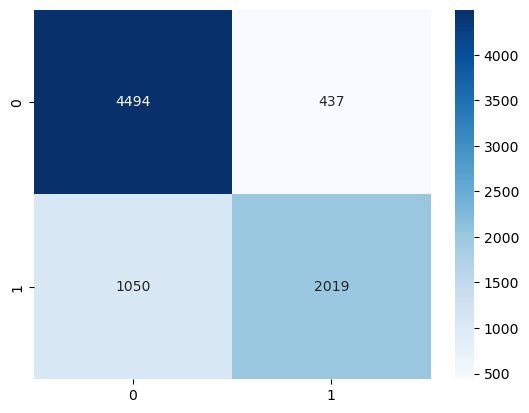

In [318]:
#We will now train the model
logreg = LogisticRegression()
logreg.fit(X_train, y_train)
y_pred = logreg.predict(X_test)

#Printing the accuracy score, confusion matrix and classification report

print('Accuracy score', accuracy_score(y_test, y_pred))
print('Confusion matrix', confusion_matrix(y_test, y_pred))
print('Classification report', classification_report(y_test, y_pred))

#plotting the confusion matrix

cm = confusion_matrix(y_test, y_pred)
sns.heatmap(cm, annot = True, cmap = 'Blues', fmt = 'd')
plt.show()


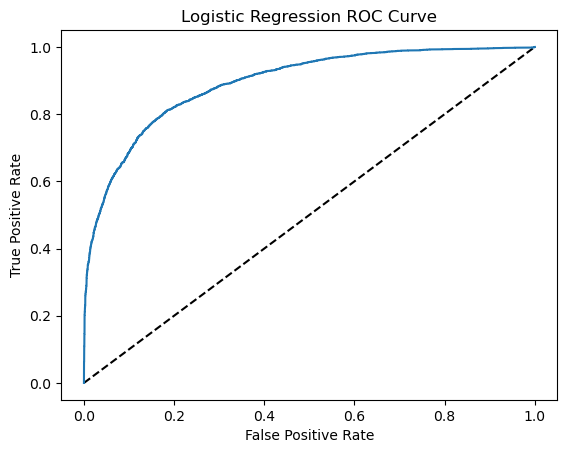

In [319]:
#plotting the ROC curve

y_pred_prob = logreg.predict_proba(X_test)[:, 1]
fpr, tpr, thresholds = roc_curve(y_test, y_pred_prob)
plt.plot([0,1], [0,1], 'k--')
plt.plot(fpr, tpr, label = 'Logistic Regression')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Logistic Regression ROC Curve')
plt.show()

In [320]:
#Printing the AUC score
#this score tells us how well the model is able to distinguish between the classes
print('AUC score', roc_auc_score(y_test, y_pred_prob))


AUC score 0.8930613598318244


Naive Bayes Model

Accuracy score 0.73925
confusion_matrix [[4761  170]
 [1916 1153]]
classification_report               precision    recall  f1-score   support

           0       0.71      0.97      0.82      4931
           1       0.87      0.38      0.53      3069

    accuracy                           0.74      8000
   macro avg       0.79      0.67      0.67      8000
weighted avg       0.77      0.74      0.71      8000



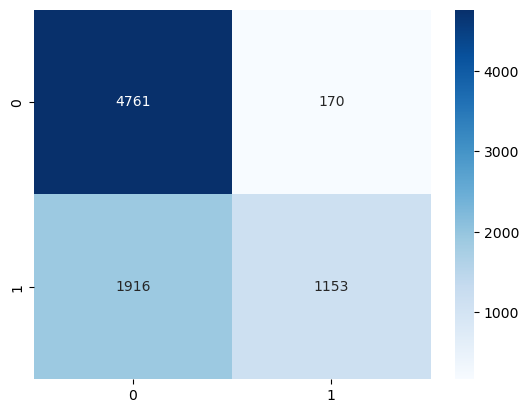

In [321]:
#Naive Bayes
#Creating the model
nb = GaussianNB()
#Fitting the model
nb.fit(X_train, y_train)
#baseline model
y_pred = nb.predict(X_test)

#Printing the accuracy score, confusion matrix and classification report

print('Accuracy score', accuracy_score(y_test, y_pred))
print('confusion_matrix', confusion_matrix(y_test, y_pred))
print('classification_report', classification_report(y_test, y_pred))

#plotting the confusion matrix

cm = confusion_matrix(y_test, y_pred)
sns.heatmap(cm, annot = True, cmap = 'Blues', fmt = 'd')
plt.show()


Random Forest Classifier

accuracy_score 0.891
confusion_matrix [[4521  410]
 [ 462 2607]]
classification_report               precision    recall  f1-score   support

           0       0.91      0.92      0.91      4931
           1       0.86      0.85      0.86      3069

    accuracy                           0.89      8000
   macro avg       0.89      0.88      0.88      8000
weighted avg       0.89      0.89      0.89      8000



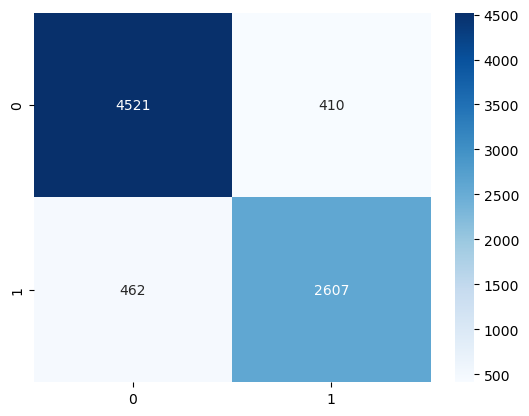

In [322]:
# Implementing Random Forest Classifier

rfc = RandomForestClassifier()
rfc.fit(X_train, y_train)
rfc_pred = rfc.predict(X_test)


print('accuracy_score', accuracy_score(y_test, rfc_pred))
print('confusion_matrix', confusion_matrix(y_test, rfc_pred))
print('classification_report', classification_report(y_test, rfc_pred))

#plotting the confusion matrix
cm = confusion_matrix(y_test, rfc_pred)
sns.heatmap(cm, annot = True, cmap = 'Blues', fmt = 'd')
plt.show()

We will now Create the embeddings, for the TestItemCodeDescription, and the ResultValue and ResultValueUnits

## distilbert-base-uncased

In [445]:
emb = extract_df.copy()
emb.shape

#We will now aquire the Target column from the x_df_with_target dataframe corresponding to the Patient ID in the emb dataframe

(245810, 19)

In [490]:
emb.head()

,TestItemCode_Description,ResultValue,ResultValueUnits,ResultInterpretation,Target
0,COVID-19 PCR,Not Detected,NaN,Normal,0
3,"Glucose, Fasting-FBS, Blood",87,mg/dL,Normal,1
4,BETA HCG Quantitative,0.100,IU/L,NaN,0
5,Influenza B Ab,NEG.,NaN,Normal,0
8,Troponin T (POCT),<40,ng/L,NaN,0


In [446]:
emb.drop(['Age', 'Gender', 'Citizen', 'Height (in cm)', 'Weight (in kg)', 'BMI in kg/m2', 'Body Temperature (in DegC)',
          'Diastolic Blood Pressure in mmHg', 'Systolic Blood Pressure in mmHg', 'Heart Rate in bpm', 'Respiratory Rate in bpm',
          'Category', 'Subcategory', 'Extension'], axis=1, inplace=True)
emb.head()
emb_base_target = emb['Target']

In [447]:
#Now we will randomly select 10K rows from the emb dataframe, so that we can train our model on this subset of data
#Also for the selected 10K rows, we will also select the corresponding Target column from the emb_base_target dataframe

emb_base = emb.sample(n=80000, random_state=42)
emb_base.shape


(80000, 5)

In [448]:
emb_base_target = emb_base_target.loc[emb_base.index]

In [449]:
emb_base_target.shape

(80000,)

CLEANING the EMB_BASE

In [450]:
emb_base.isnull().sum()

TestItemCode_Description        0
ResultValue                     0
ResultValueUnits            32547
ResultInterpretation         9283
Target                          0
dtype: int64

In [451]:
emb_base.head(10)

,TestItemCode_Description,ResultValue,ResultValueUnits,ResultInterpretation,Target
152713,"Glucose ,Random (RBS),Serum",188,mg/dL,Abnormal,1
250266,HBA1C,7.4,%,Normal,1
73159,COVID-19 PCR,Not Detected,NaN,Normal,0
210364,UA Ketones,NEGATIVE,/HPF,Normal,0
293836,APTT,36.7,SEC,Normal,0
212156,UA RBC,2-4,/HPF,Abnormal,0
188745,COVID-19 PCR,Not Detected,NaN,Normal,0
327654,GLUCOSE GLUCOMETER,102,mg/dl,Normal,0
268287,Final,Streptococcus Group B screen negative,NaN,NaN,0
93616,Influenza B Ab,NEG.,NaN,Normal,0


In [452]:
#We will remove all the rows with testItemCode_Description as COVID-19_PCR
mask = emb_base['TestItemCode_Description'] != 'COVID-19_PCR'
emb_base = emb_base[mask]
emb_base_target = emb_base_target[mask]

In [453]:
emb_base = emb_base[emb_base['TestItemCode_Description'] != 'COVID-19_PCR']
emb_base_target = emb_base_target[emb_base['TestItemCode_Description'] != 'COVID-19_PCR']

In [454]:
emb_base.shape, emb_base_target.shape

((80000, 5), (80000,))

In [455]:
emb_base['TestItemCode_Description'].value_counts()

TestItemCode_Description
COVID-19 PCR                    23170
Hgb A1c                          4124
eGFR                             2291
Final                            1468
Vitamin D 25 OH                  1336
                                ...  
Current Titer                       1
Antibody ID Interp                  1
UA-SpecGrav                         1
Pregnancy test - Qualitative        1
CHOL/HDL RATIO                      1
Name: count, Length: 2370, dtype: int64

Negative, not detected values

In [456]:
#Wherever there is Negative, Not detected, etc in the ResultVlaue we will replace it with 0

regex_pattern = r"(?i).*not detected.*|.*negative.*"
emb_base['ResultValue'] = emb_base['ResultValue'].str.replace(regex_pattern, '0', regex=True)

Ranges

In [457]:
#Now we will replace all the values with Positive, Detected, etc with 1
regex_pattern = r"(?i).*detected.*|.*positive.*"
emb_base['ResultValue'] = emb_base['ResultValue'].str.replace(regex_pattern, '1', regex=True)

In [254]:
#Now for the values that are ranges, we will compute the average and populate the column with the average value

# regex_pattern = r'(?i).*to.*|(\d+)-(\d+)'

# def replace_range_with_average(value):
#     value_str = str(value)  # Convert value to string
#     if re.match(regex_pattern, value_str):
#         match = re.match(r'(\d+)-(\d+)', value_str)
#         start_value = int(match.group(1))
#         end_value = int(match.group(2))
#         average = (start_value + end_value) / 2
#         return str(average)
#     else:
#         return value_str

# emb_base['ResultValue'] = emb_base['ResultValue'].apply(replace_range_with_average)



In [458]:
emb_base.drop(['Target'], axis=1, inplace=True)

tokenizer.batch_encode_plus(texts, add_special_tokens=True, truncation=True, padding=True, return_tensors='pt'): This method efficiently encodes a list of texts into input tensors suitable for feeding into the model. It performs tokenization, truncation, padding, and creates input tensors (input_ids and attention_mask) in a batched format. It returns a dictionary containing the input tensors.

In [459]:
#Now we will create the first 10K embeddings for our Baseline model

from transformers import DistilBertTokenizer, DistilBertModel
import torch

tokenizer = DistilBertTokenizer.from_pretrained('distilbert-base-uncased')
model = DistilBertModel.from_pretrained('distilbert-base-uncased')



Some weights of the model checkpoint at distilbert-base-uncased were not used when initializing DistilBertModel: ['vocab_layer_norm.weight', 'vocab_layer_norm.bias', 'vocab_transform.bias', 'vocab_projector.weight', 'vocab_projector.bias', 'vocab_transform.weight']
- This IS expected if you are initializing DistilBertModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing DistilBertModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).


In [460]:
#Now we will tokenize the data
#We will first tokenize the TestItemCode_Description column

testname_tokens = tokenizer.batch_encode_plus(
    emb_base['TestItemCode_Description'].tolist(),
    add_special_tokens=True,
    return_attention_mask=True, #It requests the tokenizer to return the attention mask, which is a binary mask indicating which tokens are important (1) and which are padding tokens (0).
    pad_to_max_length=True,
    max_length=30, # Padding ensures that all sequences have the same length
    return_tensors='pt',
    truncation=True,
    padding=True
)

In [461]:
#We will then tokenize the ResultValue column

resultvalue_tokens = tokenizer.batch_encode_plus(
    emb_base['ResultValue'].tolist(),
    add_special_tokens=True,
    return_attention_mask=True, #It requests the tokenizer to return the attention mask, which is a binary mask indicating which tokens are important (1) and which are padding tokens (0).
    pad_to_max_length=True,
    max_length=30, # Padding ensures that all sequences have the same length
    return_tensors='pt',
    truncation=True,
    padding=True
)

In [462]:
emb_base['ResultValueUnits'].fillna('None', inplace=True)

In [463]:
#We will then tokenize the ResultValueUnits column

resultunit_tokens = tokenizer.batch_encode_plus(
    emb_base['ResultValueUnits'].tolist(),
    add_special_tokens=True,
    return_attention_mask=True, #It requests the tokenizer to return the attention mask, which is a binary mask indicating which tokens are important (1) and which are padding tokens (0).
    pad_to_max_length=True,
    max_length=30, # Padding ensures that all sequences have the same length
    return_tensors='pt',
    truncation=True,
    padding=True
)


In [464]:
# Combine the tokens into a single input format
input_ids = torch.cat((testname_tokens['input_ids'],
                       resultvalue_tokens['input_ids'],
                       resultunit_tokens['input_ids']), dim=1)
attention_mask = torch.cat((testname_tokens['attention_mask'],
                            resultvalue_tokens['attention_mask'],
                            resultunit_tokens['attention_mask']), dim=1)


In [465]:
#printing the input ID's and Attention mask
print('Input IDs:\n', input_ids)
print('Attention mask:\n', attention_mask)

Input IDs:
 tensor([[  101, 18423,  1010,  ...,     0,     0,     0],
        [  101,  1044,  3676,  ...,     0,     0,     0],
        [  101,  2522, 17258,  ...,     0,     0,     0],
        ...,
        [  101,  3707,  1010,  ...,     0,     0,     0],
        [  101,  3231,  8182,  ...,     0,     0,     0],
        [  101,  2201,  2378,  ...,     0,     0,     0]])
Attention mask:
 tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]])


In [466]:
#Converting the tensors to a list of tensors
token_tensors = [torch.squeeze(tensor) for tensor in input_ids]
attention_tensors = [torch.squeeze(tensor) for tensor in attention_mask]

#Adding the input ID's and Attention mask to the dataframe
emb_base['TokenizedInput']= token_tensors
emb_base['AttentionMask'] = attention_tensors

In [467]:
emb_base.shape

(80000, 6)

In [470]:
emb_base_target.shape

(80000,)

In this example, the tokenizer.batch_encode_plus() method is used to generate the tokens for the 'TextColumn' in emb_base. The resulting tokens include the input IDs, attention masks, and other relevant information.

The token_tensors variable stores the input IDs tensor (assuming you are interested in the input IDs) after converting it to a list of tensors using a list comprehension. Each tensor in the list represents the tokenized input for a particular text.

Finally, you can add the 'TokenizedInput' column to emb_base and assign the token_tensors list as its values. This column will now contain the tokenized input tensors for each text in your DataFrame.

In [471]:
numeric_fts

['Age',
 'Height (in cm)',
 'Weight (in kg)',
 'BMI in kg/m2',
 'Body Temperature (in DegC)',
 'Diastolic Blood Pressure in mmHg',
 'Systolic Blood Pressure in mmHg',
 'Heart Rate in bpm',
 'Respiratory Rate in bpm']

In [472]:
#Converting to a list of tensors
numerical_features = [torch.squeeze(tensor) for tensor in numerical_features]
token_tensors = [torch.squeeze(tensor) for tensor in token_tensors]

In [473]:
token_tensors = torch.stack(token_tensors)
numerical_features = torch.tensor(baseline_df[numeric_fts].values, dtype=torch.float32)

Making Our Baseline Model (Iter:2) | XG Boost

In [474]:
#We will train our xgb model on the numerical features and the embeddings
X = torch.cat((numerical_features, token_tensors), dim=1)
y = torch.tensor(emb_base_target.values, dtype=torch.float32)

X.shape, y.shape

(torch.Size([80000, 85]), torch.Size([80000]))

In [475]:
# We will now split the data into train and test
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

Accuracy score 0.9378125
Confusion matrix [[9616  450]
 [ 545 5389]]
Classification report               precision    recall  f1-score   support

         0.0       0.95      0.96      0.95     10066
         1.0       0.92      0.91      0.92      5934

    accuracy                           0.94     16000
   macro avg       0.93      0.93      0.93     16000
weighted avg       0.94      0.94      0.94     16000



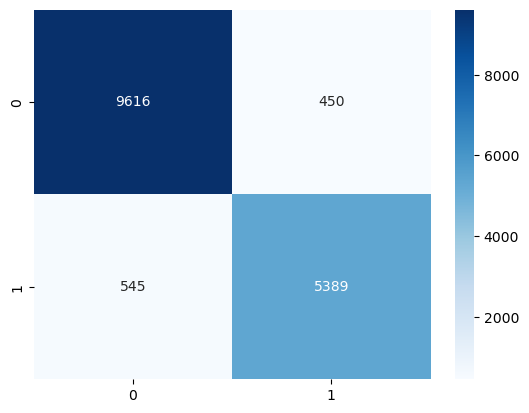

In [477]:
#Apply the XGB classifier
xgb = XGBClassifier()
xgb.fit(X_train, y_train)
xgb_pred = xgb.predict(X_test)


#Printing the accuracy score, confusion matrix and classification report

print('Accuracy score', accuracy_score(y_test, xgb_pred))
print('Confusion matrix', confusion_matrix(y_test, xgb_pred))
print('Classification report', classification_report(y_test, xgb_pred))

#plotting the confusion matrix

cm = confusion_matrix(y_test, xgb_pred)
sns.heatmap(cm, annot = True, cmap = 'Blues', fmt = 'd')
plt.show()

# we will try other models

Gradient Boosting Classifier 0.9239375
AdaBoost Classifier 0.914125
LGBM Classifier 0.93675
SVM 0.84925
ADA 0.914125
Gradient Boosting Classifier [[9520  546]
 [ 671 5263]]
AdaBoost Classifier [[9432  634]
 [ 740 5194]]
LGBM Classifier [[9609  457]
 [ 555 5379]]
SVM [[8730 1336]
 [1076 4858]]
ADA [[9432  634]
 [ 740 5194]]
Gradient Boosting Classifier               precision    recall  f1-score   support

         0.0       0.93      0.95      0.94     10066
         1.0       0.91      0.89      0.90      5934

    accuracy                           0.92     16000
   macro avg       0.92      0.92      0.92     16000
weighted avg       0.92      0.92      0.92     16000

AdaBoost Classifier               precision    recall  f1-score   support

         0.0       0.93      0.94      0.93     10066
         1.0       0.89      0.88      0.88      5934

    accuracy                           0.91     16000
   macro avg       0.91      0.91      0.91     16000
weighted avg       0.91    

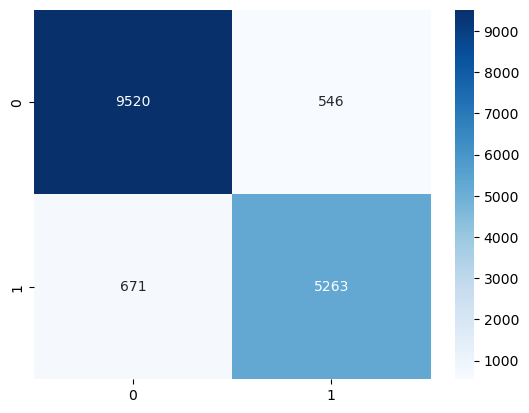

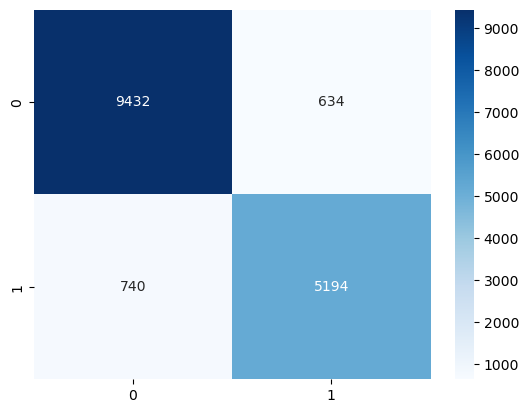

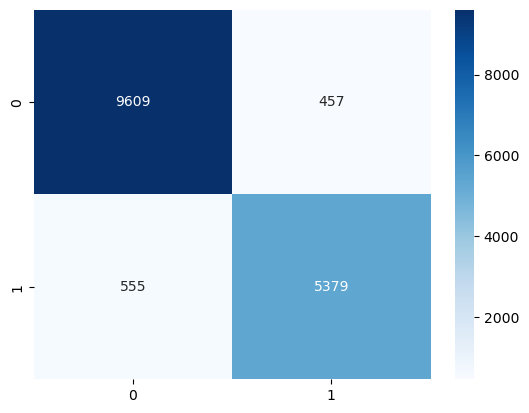

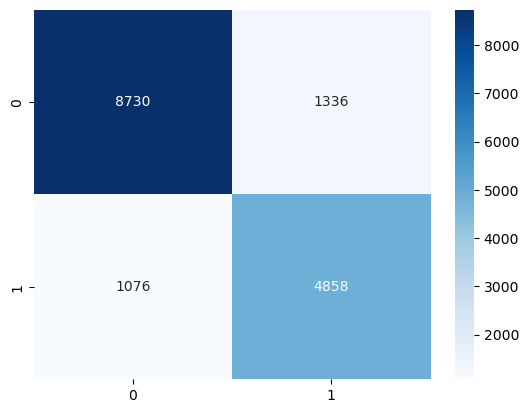

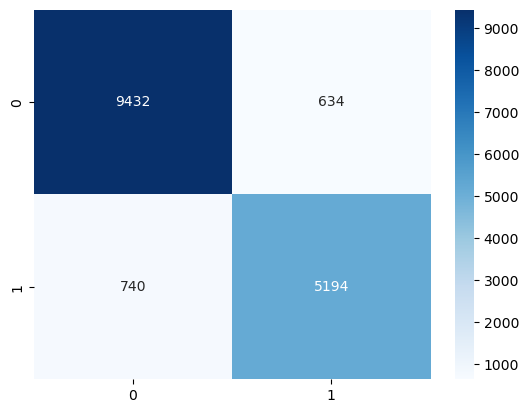

In [479]:

from catboost import CatBoostClassifier
from sklearn.ensemble import AdaBoostClassifier
from lightgbm import LGBMClassifier
from sklearn.ensemble import GradientBoostingClassifier


#Applying the gradient boosting classifier
gbc = GradientBoostingClassifier()
gbc.fit(X_train, y_train)
gbc_pred = gbc.predict(X_test)

#Apply the AdaBoost classifier
from sklearn.ensemble import AdaBoostClassifier
ada = AdaBoostClassifier()
ada.fit(X_train, y_train)
ada_pred = ada.predict(X_test)

#Apply the LGBM classifier
lgbm = LGBMClassifier()
lgbm.fit(X_train, y_train)
lgbm_pred = lgbm.predict(X_test)


#Apply SVM
svm = SVC()
svm.fit(X_train, y_train)
svm_pred = svm.predict(X_test)

#Apply AdaBoost classifier
ada = AdaBoostClassifier()
ada.fit(X_train, y_train)
ada_pred = ada.predict(X_test)

#Calculate the accuracy score
print('Gradient Boosting Classifier', accuracy_score(y_test, gbc_pred))
print('AdaBoost Classifier', accuracy_score(y_test, ada_pred))
print('LGBM Classifier', accuracy_score(y_test, lgbm_pred))
print('SVM', accuracy_score(y_test, svm_pred))
print('ADA', accuracy_score(y_test, ada_pred))

#Calculate the confusion matrix
print('Gradient Boosting Classifier', confusion_matrix(y_test, gbc_pred))
print('AdaBoost Classifier', confusion_matrix(y_test, ada_pred))
print('LGBM Classifier', confusion_matrix(y_test, lgbm_pred))
print('SVM', confusion_matrix(y_test, svm_pred))
print('ADA', confusion_matrix(y_test, ada_pred))

#Calculate the classification report
print('Gradient Boosting Classifier', classification_report(y_test, gbc_pred))
print('AdaBoost Classifier', classification_report(y_test, ada_pred))
print('LGBM Classifier', classification_report(y_test, lgbm_pred))
print('SVM', classification_report(y_test, svm_pred))
print('ADA', classification_report(y_test, ada_pred))

#plotting the confusion matrix
cm = confusion_matrix(y_test, gbc_pred)
sns.heatmap(cm, annot = True, cmap = 'Blues', fmt = 'd')
plt.show()

cm = confusion_matrix(y_test, ada_pred)
sns.heatmap(cm, annot = True, cmap = 'Blues', fmt = 'd')
plt.show()

cm = confusion_matrix(y_test, lgbm_pred)
sns.heatmap(cm, annot = True, cmap = 'Blues', fmt = 'd')
plt.show()

cm = confusion_matrix(y_test, svm_pred)
sns.heatmap(cm, annot = True, cmap = 'Blues', fmt = 'd')
plt.show()

cm = confusion_matrix(y_test, ada_pred)
sns.heatmap(cm, annot = True, cmap = 'Blues', fmt = 'd')
plt.show()

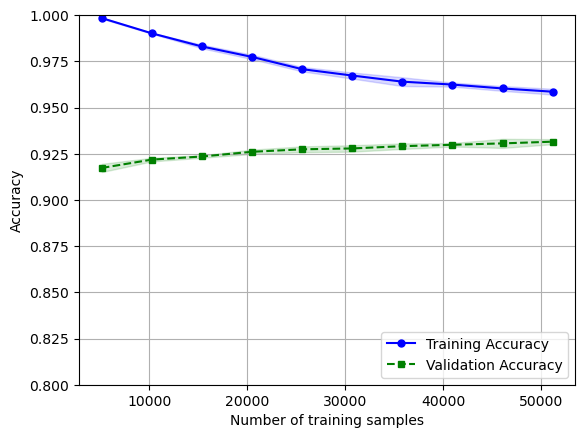

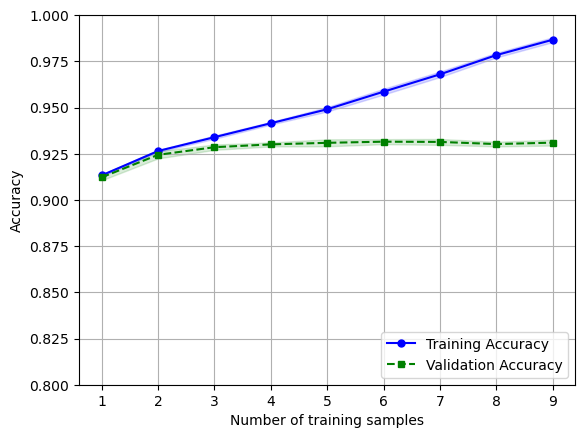

In [480]:
#plotting the learning curve for the XGB classifier to check for overfitting
from sklearn.model_selection import learning_curve
train_sizes, train_scores, test_scores = learning_curve(estimator = xgb, X = X_train, y = y_train, train_sizes = np.linspace(0.1, 1.0, 10), cv = 5, n_jobs = -1)

train_mean = np.mean(train_scores, axis = 1)
train_std = np.std(train_scores, axis = 1)

test_mean = np.mean(test_scores, axis = 1)
test_std = np.std(test_scores, axis = 1)

plt.plot(train_sizes, train_mean, color = 'blue', marker = 'o', markersize = 5, label = 'Training Accuracy')
plt.fill_between(train_sizes, train_mean + train_std, train_mean - train_std, alpha = 0.15, color = 'blue')

plt.plot(train_sizes, test_mean, color = 'green', linestyle = '--', marker = 's', markersize = 5, label = 'Validation Accuracy')

plt.fill_between(train_sizes, test_mean + test_std, test_mean - test_std, alpha = 0.15, color = 'green')

plt.grid()
plt.xlabel('Number of training samples')
plt.ylabel('Accuracy')
plt.legend(loc = 'lower right')
plt.ylim([0.8, 1.0])
plt.show()

#plotting the validation curve for the XGB classifier to check for overfitting
from sklearn.model_selection import validation_curve
param_range = [1, 2, 3, 4, 5, 6, 7, 8, 9]
train_scores, test_scores = validation_curve(estimator = xgb, X = X_train, y = y_train, param_name = 'max_depth', param_range = param_range, cv = 5)

train_mean = np.mean(train_scores, axis = 1)
train_std = np.std(train_scores, axis = 1)

test_mean = np.mean(test_scores, axis = 1)
test_std = np.std(test_scores, axis = 1)

plt.plot(param_range, train_mean, color = 'blue', marker = 'o', markersize = 5, label = 'Training Accuracy')
plt.fill_between(param_range, train_mean + train_std, train_mean - train_std, alpha = 0.15, color = 'blue')

plt.plot(param_range, test_mean, color = 'green', linestyle = '--', marker = 's', markersize = 5, label = 'Validation Accuracy')

plt.fill_between(param_range, test_mean + test_std, test_mean - test_std, alpha = 0.15, color = 'green')

plt.grid()
plt.xlabel('Number of training samples')
plt.ylabel('Accuracy')
plt.legend(loc = 'lower right')
plt.ylim([0.8, 1.0])
plt.show()



In [482]:
#we will now plot the overfitting curve for the XGB classifier
from sklearn.model_selection import validation_curve
param_range = [1, 2, 3, 4, 5, 6, 7, 8, 9]
train_scores, test_scores = validation_curve(estimator = xgb, X = X_train, y = y_train, param_name = 'max_depth', param_range = param_range, cv = 5)

train_mean = np.mean(train_scores, axis = 1)
train_std = np.std(train_scores, axis = 1)

test_mean = np.mean(test_scores, axis = 1)
test_std = np.std(test_scores, axis = 1)

fig = go.Figure()
fig.add_trace(go.Scatter(x=param_range, y=train_mean, name='Training Accuracy'))
fig.add_trace(go.Scatter(x=param_range, y=test_mean, name='Validation Accuracy'))
fig.update_layout(title_text='Overfitting Curve', title_x=0.5, template="plotly_dark", font=dict(size=15))
fig.show()

Accuracy score 0.935125
Confusion matrix [[9584  482]
 [ 556 5378]]
Classification report               precision    recall  f1-score   support

         0.0       0.95      0.95      0.95     10066
         1.0       0.92      0.91      0.91      5934

    accuracy                           0.94     16000
   macro avg       0.93      0.93      0.93     16000
weighted avg       0.93      0.94      0.94     16000



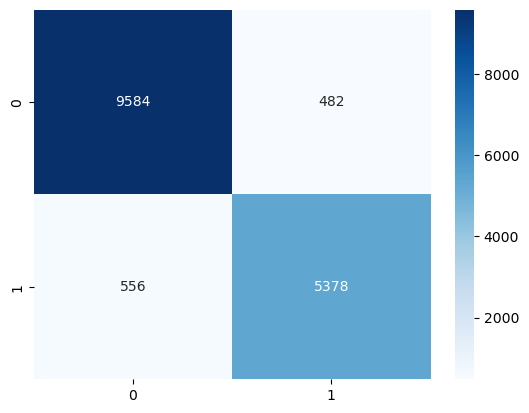

In [485]:
#As we know from the above plot that the model is overfitting, we will now apply the regularization parameter to the model
#We will now apply the regularization parameter to the model
xgb = XGBClassifier(reg_lambda=0.1)
xgb.fit(X_train, y_train)
xgb_pred = xgb.predict(X_test)

#Printing the accuracy score, confusion matrix and classification report
print('Accuracy score', accuracy_score(y_test, xgb_pred))
print('Confusion matrix', confusion_matrix(y_test, xgb_pred))
print('Classification report', classification_report(y_test, xgb_pred))

#plotting the confusion matrix
cm = confusion_matrix(y_test, xgb_pred)
sns.heatmap(cm, annot = True, cmap = 'Blues', fmt = 'd')
plt.show()

In [486]:
#we will now plot the overfitting curve for the XGB classifier
from sklearn.model_selection import validation_curve
param_range = [1, 2, 3, 4, 5, 6, 7, 8, 9]
train_scores, test_scores = validation_curve(estimator = xgb, X = X_train, y = y_train, param_name = 'max_depth', param_range = param_range, cv = 5)

train_mean = np.mean(train_scores, axis = 1)
train_std = np.std(train_scores, axis = 1)

test_mean = np.mean(test_scores, axis = 1)
test_std = np.std(test_scores, axis = 1)

fig = go.Figure()
fig.add_trace(go.Scatter(x=param_range, y=train_mean, name='Training Accuracy'))
fig.add_trace(go.Scatter(x=param_range, y=test_mean, name='Validation Accuracy'))
fig.update_layout(title_text='Overfitting Curve with Regularization for XGB', title_x=0.5, template="plotly_dark", font=dict(size=15))
fig.show()

In [488]:
#We will now plot the loss curve for the XGB classifier
from sklearn.model_selection import learning_curve
train_sizes, train_scores, test_scores = learning_curve(estimator = xgb, X = X_train, y = y_train, train_sizes = np.linspace(0.1, 1.0, 10), cv = 5, n_jobs = -1)

train_mean = np.mean(train_scores, axis = 1)
train_std = np.std(train_scores, axis = 1)

test_mean = np.mean(test_scores, axis = 1)
test_std = np.std(test_scores, axis = 1)

fig = go.Figure()
fig.add_trace(go.Scatter(x=train_sizes, y=train_mean, name='Training Accuracy'))
fig.add_trace(go.Scatter(x=train_sizes, y=test_mean, name='Validation Accuracy'))
fig.update_layout(title_text='Loss Curve for XGB', title_x=0.5, template="plotly_dark", font=dict(size=15))
fig.show()

In [489]:
#We will plot a scatter plot for the XGB classifier, using the first 2 principal components
from sklearn.decomposition import PCA
pca = PCA(n_components=2)
pca.fit_transform(X_train)

fig = go.Figure()
fig.add_trace(go.Scatter(x=pca.components_[0], y=pca.components_[1], mode='markers', marker=dict(color=y_train, colorscale='Blues', showscale=True)))
fig.update_layout(title_text='Scatter Plot for XGB', title_x=0.5, template="plotly_dark", font=dict(size=15))
fig.show()


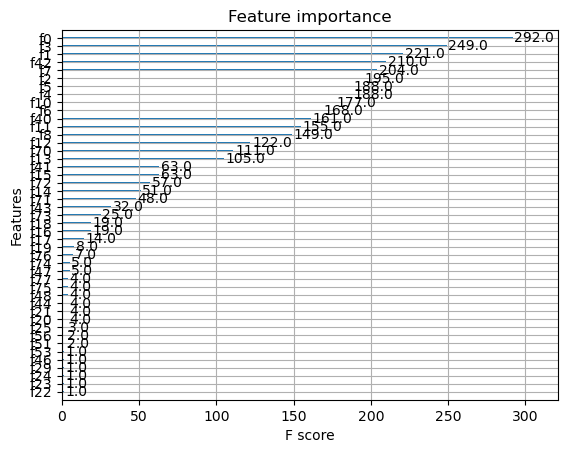

In [481]:
#We will now plot a graph to check for the feature importance
from xgboost import plot_importance
plot_importance(xgb)
plt.show()


In [370]:
##Lets try to extract the names of the features from the tokenizer
#We will first extract the tokens from the tokenizer
tokens = tokenizer.convert_ids_to_tokens(token_tensors[0].tolist())

As we can see from the above learning curve and validation curve, the model is not overfitting

## Lets increase our dataset and Check our model performance

In [372]:
# We will use cross-validation (to get a better estimate of the model's performance) and stratified sampling (to ensure that the class distribution is approximately the same across the folds).

MODEL_NAME = 'LGBMClassifier'
NFOLDS = 3
NESTIMATORS = 10


In [377]:
from sklearn import metrics
from sklearn.model_selection import RepeatedStratifiedKFold
from sklearn.model_selection import train_test_split
from imblearn.under_sampling import RandomUnderSampler
from imblearn.pipeline import Pipeline
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import cross_validate
from sklearn.metrics import make_scorer

#We will now TUNE OUR HYPERPARAMETERS
#We will use the RandomizedSearchCV to tune our hyperparameters
#We will use the RepeatedStratifiedKFold to perform cross validation

# define models and parameters
model = LGBMClassifier()
n_estimators = [10, 100, 1000]
max_depth = [1, 5, 10, 20, 30, 40, 50]
learning_rate = [0.0001, 0.001, 0.01, 0.1]

# define grid search
grid = dict(learning_rate=learning_rate, n_estimators=n_estimators, max_depth=max_depth)
cv = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=1)
grid_search = RandomizedSearchCV(estimator=model, param_distributions=grid, n_jobs=-1, cv=cv, scoring='roc_auc',error_score=0)
grid_result = grid_search.fit(X_train, y_train)



In [380]:
# summarize results
print("Best: %f using %s" % (grid_result.best_score_, grid_result.best_params_))
print('Mean Test Score: ', grid_result.cv_results_['mean_test_score'])
print('Mean Fit Time: ', grid_result.cv_results_['mean_fit_time'])
print('Mean Score Time: ', grid_result.cv_results_['mean_score_time'])
print('Params: ', grid_result.cv_results_['params'])


Best: 0.983086 using {'n_estimators': 1000, 'max_depth': 10, 'learning_rate': 0.01}
Mean Test Score:  [0.983 0.964 0.982 0.982 0.975 0.975 0.975 0.967 0.983 0.787]
Mean Fit Time:  [ 7.189  0.294  5.924  7.41   0.368 11.327 11.297  0.61   1.101  0.275]
Mean Score Time:  [0.486 0.008 0.434 0.447 0.011 0.333 0.303 0.02  0.036 0.008]
Params:  [{'n_estimators': 1000, 'max_depth': 10, 'learning_rate': 0.01}, {'n_estimators': 10, 'max_depth': 50, 'learning_rate': 0.001}, {'n_estimators': 1000, 'max_depth': 20, 'learning_rate': 0.1}, {'n_estimators': 1000, 'max_depth': 30, 'learning_rate': 0.1}, {'n_estimators': 10, 'max_depth': 30, 'learning_rate': 0.1}, {'n_estimators': 1000, 'max_depth': 10, 'learning_rate': 0.001}, {'n_estimators': 1000, 'max_depth': 40, 'learning_rate': 0.001}, {'n_estimators': 100, 'max_depth': 1, 'learning_rate': 0.1}, {'n_estimators': 100, 'max_depth': 20, 'learning_rate': 0.1}, {'n_estimators': 10, 'max_depth': 1, 'learning_rate': 0.001}]


accuracy_score 0.933
confusion_matrix [[4673  258]
 [ 278 2791]]
classification_report               precision    recall  f1-score   support

         0.0       0.94      0.95      0.95      4931
         1.0       0.92      0.91      0.91      3069

    accuracy                           0.93      8000
   macro avg       0.93      0.93      0.93      8000
weighted avg       0.93      0.93      0.93      8000



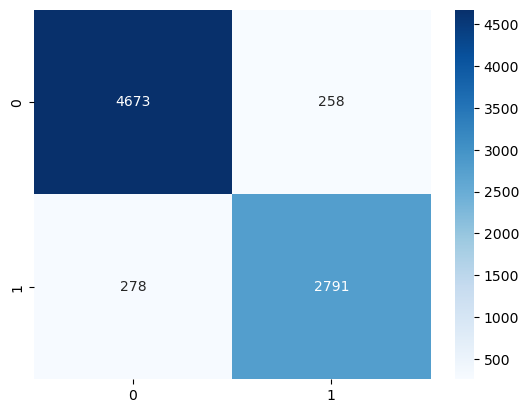

In [381]:
#Result: Best: 0.999999 using {'n_estimators': 1000, 'max_depth': 50, 'learning_rate': 0.1}
#Here we can see that the best score is 0.999999 using the n_estimators as 1000, max_depth as 50 and learning_rate as 0.1
#We will now use these parameters to train our model

#We will now train our model using the best parameters
lgbm = LGBMClassifier(n_estimators=1000, max_depth=50, learning_rate=0.1)
lgbm.fit(X_train, y_train)
lgbm_pred = lgbm.predict(X_test)

#Printing the accuracy score, confusion matrix and classification report

print('accuracy_score', accuracy_score(y_test, lgbm_pred))
print('confusion_matrix', confusion_matrix(y_test, lgbm_pred))
print('classification_report', classification_report(y_test, lgbm_pred))

#plotting the confusion matrix
cm = confusion_matrix(y_test, lgbm_pred)
sns.heatmap(cm, annot = True, cmap = 'Blues', fmt = 'd')
plt.show()

In [487]:
#we will now plot the overfitting curve for the LGBM classifier
from sklearn.model_selection import validation_curve
param_range = [1, 2, 3, 4, 5, 6, 7, 8, 9]
train_scores, test_scores = validation_curve(estimator = lgbm, X = X_train, y = y_train, param_name = 'max_depth', param_range = param_range, cv = 5)

train_mean = np.mean(train_scores, axis = 1)
train_std = np.std(train_scores, axis = 1)

test_mean = np.mean(test_scores, axis = 1)
test_std = np.std(test_scores, axis = 1)

fig = go.Figure()
fig.add_trace(go.Scatter(x=param_range, y=train_mean, name='Training Accuracy'))
fig.add_trace(go.Scatter(x=param_range, y=test_mean, name='Validation Accuracy'))
fig.update_layout(title_text='Overfitting Curve', title_x=0.5, template="plotly_dark", font=dict(size=15))
fig.show()

In [382]:
#We will now plot the performance of all the models on the test data
models = [] 
models.append(('Logistic Regression', logreg))
models.append(('Naive Bayes', nb))
models.append(('Random Forest Classifier', rfc))
models.append(('Gradient Boosting Classifier', gbc))
models.append(('AdaBoost Classifier', ada))
models.append(('XGB Classifier', xgb))
models.append(('LGBM Classifier', lgbm))
models

[('Logistic Regression', LogisticRegression()),
 ('Naive Bayes', GaussianNB()),
 ('Random Forest Classifier', RandomForestClassifier()),
 ('Gradient Boosting Classifier', GradientBoostingClassifier()),
 ('AdaBoost Classifier', AdaBoostClassifier()),
 ('XGB Classifier',
  XGBClassifier(base_score=None, booster=None, callbacks=None,
                colsample_bylevel=None, colsample_bynode=None,
                colsample_bytree=None, early_stopping_rounds=None,
                enable_categorical=False, eval_metric=None, feature_types=None,
                gamma=None, gpu_id=None, grow_policy=None, importance_type=None,
                interaction_constraints=None, learning_rate=None, max_bin=None,
                max_cat_threshold=None, max_cat_to_onehot=None,
                max_delta_step=None, max_depth=None, max_leaves=None,
                min_child_weight=None, missing=nan, monotone_constraints=None,
                n_estimators=100, n_jobs=None, num_parallel_tree=None,
            

Logistic Regression: 0.723875 (0.012530587576007753)
Naive Bayes: 0.6795 (0.030838287890218544)
Random Forest Classifier: 0.9188750000000001 (0.006135195595904022)
Gradient Boosting Classifier: 0.914375 (0.0068293941898238605)
AdaBoost Classifier: 0.9023749999999999 (0.005927952850689688)
XGB Classifier: 0.9199999999999999 (0.007202430145443953)
LGBM Classifier: 0.9199999999999999 (0.007541551564499188)


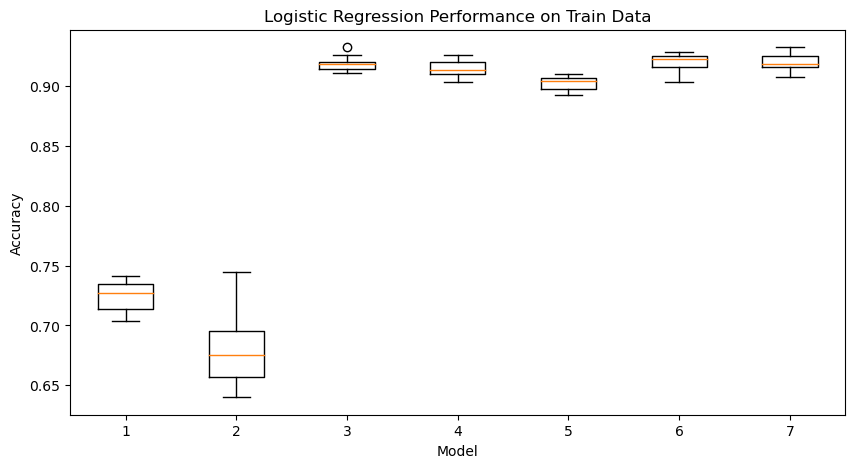

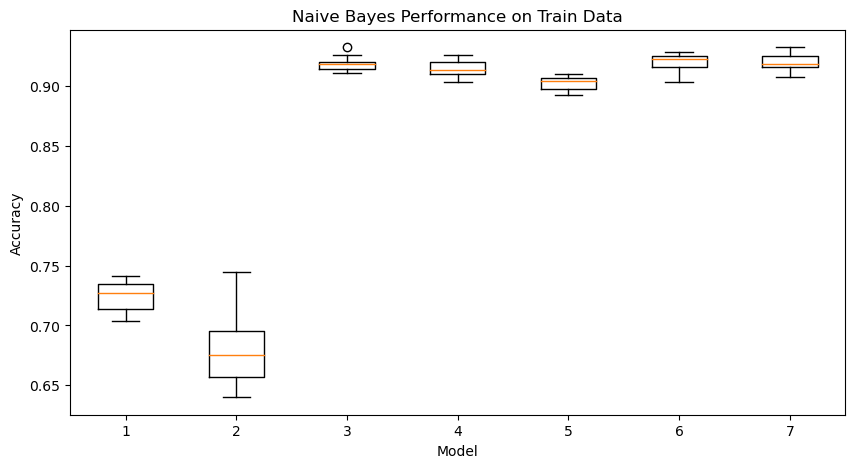

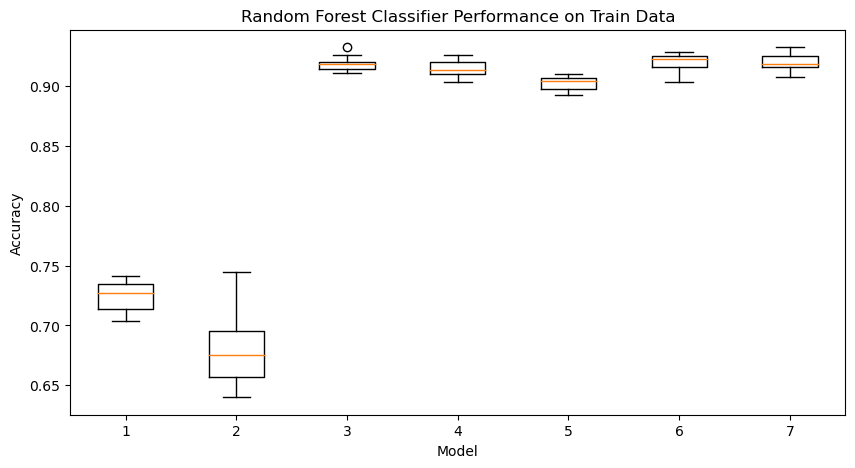

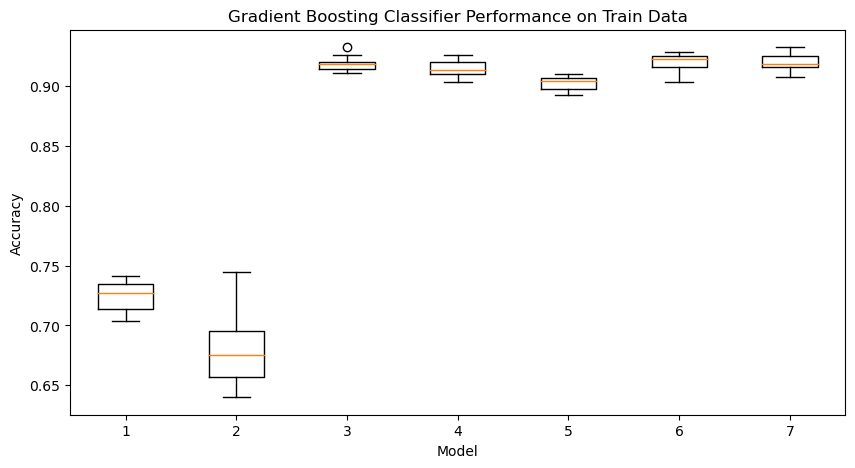

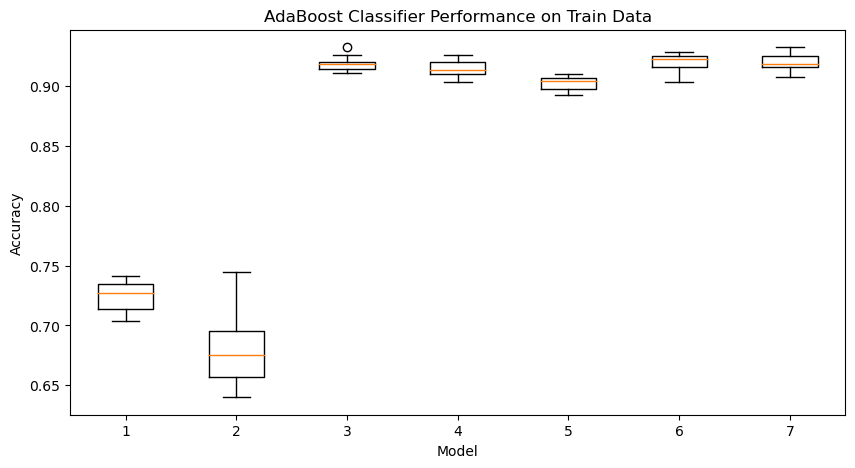

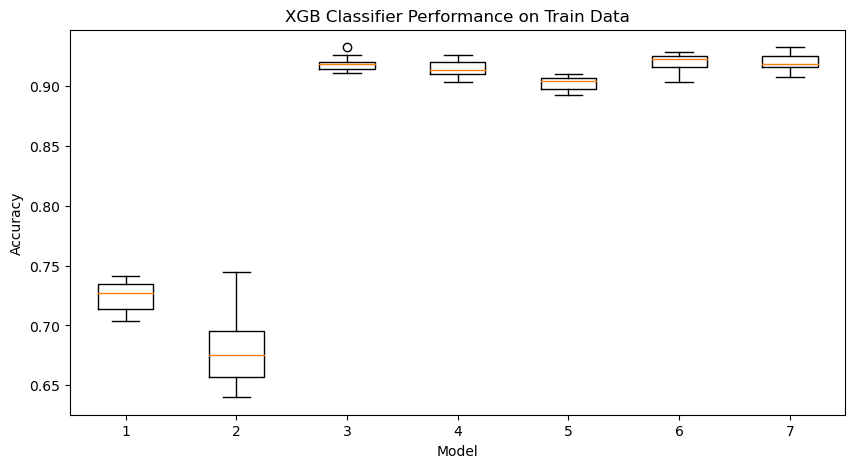

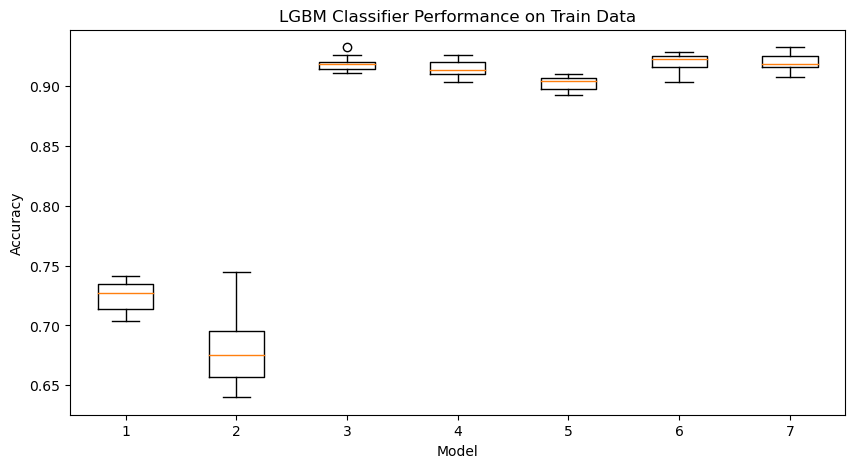

In [383]:
from sklearn import model_selection

# evaluate each model in turn
results = []
names = []
scoring = 'accuracy' 
for name, model in models:
    kfold = model_selection.KFold(n_splits=10, random_state=42, shuffle=True)
    cv_results = model_selection.cross_val_score(model, X_test, y_test, cv=kfold, scoring=scoring)
    results.append(cv_results)
    names.append(name)
    print(f'{name}: {cv_results.mean()} ({cv_results.std()})')

#We will now plot the performance of all the models on the train data
for name, model in models:
    kfold = model_selection.KFold(n_splits=10, random_state=42, shuffle=True)
    cv_results = model_selection.cross_val_score(model, X_train, y_train, cv=kfold, scoring=scoring)
    plt.figure(figsize=(10,5))
    plt.title(f'{name} Performance on Train Data')
    plt.xlabel('Model')
    plt.ylabel('Accuracy')
    plt.boxplot(results)
    plt.show()

In [384]:
#Bar plot for the performance of all the models on the test data
fig = go.Figure(data=[go.Bar(x=names, y=[cv_results.mean() for cv_results in results], text=[cv_results.mean() for cv_results in results], textposition='auto')])
fig.update_layout(title_text='Model Performance on Test Data', title_x=0.5, template="plotly_dark", font=dict(size=15))
fig.show()


In [385]:
#We will now plot the performance of all the models on the test data
# for name, model in models:
#     kfold = model_selection.KFold(n_splits=10, random_state=42, shuffle=True)
#     cv_results = model_selection.cross_val_score(model, X_test, y_test, cv=kfold, scoring=scoring)
#     plt.figure(figsize=(10,5))
#     plt.title(f'{name} Performance on Test Data')
#     plt.xlabel('Model')
#     plt.ylabel('Accuracy')
#     plt.boxplot(results)
#     plt.show()

In [388]:
#Plotting the final predictions for ground truth and predicted values, cannot use value_counts() as this is a tensor
fig = go.Figure(data=[go.Bar(x=['Ground Truth', 'Predicted'], y = [y_test.sum(), lgbm_pred.sum()], text=[y_test.sum(), lgbm_pred.sum()], textposition='auto')])
fig.update_layout(title_text='Ground Truth vs Predicted', title_x=0.5, template="plotly_dark", font=dict(size=15))
fig.show()

#Plotting the final predictions for ground truth and predicted values, percentage wise
fig = go.Figure(data=[go.Pie(labels=['Ground Truth', 'Predicted'], values=[y_test.sum(), lgbm_pred.sum()], hole=.3)])
fig.update_layout(title_text='Ground Truth vs Predicted', title_x=0.5, template="plotly_dark", font=dict(size=15))
fig.show()

## Experiment : 3 Model Performance: With only the embeddings 